# Übung 1 Einlesen und Anzeigen der Datensätze

**German Traffic Sign Detection Benchmark**

Detallierte Beschreibung des Datensatzes siehe unter folgendem [Link](http://benchmark.ini.rub.de/?section=gtsdb&subsection=news)

## Imports

In [1]:
# Die folgenden Anweisungen müssen nur ein mal ausgeführt werden
!pip install -U -q ipywidgets
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


In [8]:
import os

import csv
import wget
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display
from ipywidgets import interact, interactive, fixed, interact_manual, widgets

In [9]:
# Testfunktion für ipywidgets: 
# Es soll ein Slider angezeigt werden. Der Wertebereich des Sliders
# soll zwischen -10(min) und 30(max) liegen. 
# Entsprechend der Sliderposition soll ein Ergebniswert angezeigt werden.
def f(x):
    return 3 * x
interact(f, x= 10);

interactive(children=(IntSlider(value=10, description='x', max=30, min=-10), Output()), _dom_classes=('widget-…

## Verwendete  Module / Funktionen

Mache dich mit der Funktionsweise foldender Module / Funktionen vertraut.
Sie können zur Lösung der Aufgaben eingesetzt werden.
- os.path
- os.listdir
- [csv.reader](https://docs.python.org/3/library/csv.html)
- string.split
- np.unique
- list.append
- plt.imread
- plt.imshow
- plt.show
- dict
- zip
- dict(zip())
- sorted
- cv2.rectangle
- cv2.putText
- dict.keys
- dict.values
- enumerate
- range
- interact

## Aufgabe 1 – Einlesen der "Ground Truth"-Textdatei

### Aufgabe 1.a
Lade den Datensatz herunter und entpacke ihn.
Unter folgendem [Link](https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/published-archive.html) kannst du die Kurzbeschreibung des Datensatzes einsehen.

In [10]:
# Es wird ein Weilchen dauern die Daten herunterzuladen (1,54GB)
# Nach dem erfolgreichen Herunterladen kann dieser Block auskommentiert werden
url = "https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/FullIJCNN2013.zip"
wget.download(url)

  0% [                                                                    ]    2842624 / 1661866983

  0% [                                                                    ]    5586944 / 1661866983

  0% [                                                                    ]   12312576 / 1661866983

  1% [                                                                    ]   20348928 / 1661866983

  1% [.                                                                   ]   26574848 / 1661866983

  2% [.                                                                   ]   33710080 / 1661866983

  2% [.                                                                   ]   38608896 / 1661866983

  2% [.                                                                   ]   44244992 / 1661866983

  2% [.                                                                   ]   48693248 / 1661866983

  3% [..                                                                  ]   53944320 / 1661866983

  3% [..                                                                  ]   59449344 / 1661866983

  3% [..                                                                  ]   62308352 / 1661866983

  4% [..                                                                  ]   69476352 / 1661866983

  4% [...                                                                 ]   74571776 / 1661866983

  4% [...                                                                 ]   78479360 / 1661866983

  4% [...                                                                 ]   82419712 / 1661866983

  5% [...                                                                 ]   87244800 / 1661866983

  5% [...                                                                 ]   92069888 / 1661866983

  5% [...                                                                 ]   97198080 / 1661866983

  6% [....                                                                ]  102293504 / 1661866983

  6% [....                                                                ]  106913792 / 1661866983

  6% [....                                                                ]  112205824 / 1661866983

  7% [....                                                                ]  117596160 / 1661866983

  7% [.....                                                               ]  122896384 / 1661866983

  7% [.....                                                               ]  127434752 / 1661866983

  7% [.....                                                               ]  132497408 / 1661866983

  8% [.....                                                               ]  137584640 / 1661866983

  8% [.....                                                               ]  142852096 / 1661866983

  8% [......                                                              ]  148086784 / 1661866983

  9% [......                                                              ]  153116672 / 1661866983

  9% [......                                                              ]  158105600 / 1661866983

  9% [......                                                              ]  163004416 / 1661866983

 10% [......                                                              ]  168058880 / 1661866983

 10% [.......                                                             ]  172556288 / 1661866983

 10% [.......                                                             ]  177389568 / 1661866983

 10% [.......                                                             ]  182222848 / 1661866983

 11% [.......                                                             ]  186892288 / 1661866983

 11% [.......                                                             ]  191766528 / 1661866983

 11% [........                                                            ]  196354048 / 1661866983

 12% [........                                                            ]  201146368 / 1661866983

 12% [........                                                            ]  205742080 / 1661866983

 12% [........                                                            ]  210558976 / 1661866983

 12% [........                                                            ]  215711744 / 1661866983

 13% [........                                                            ]  219570176 / 1661866983

 13% [.........                                                           ]  223739904 / 1661866983

 13% [.........                                                           ]  225779712 / 1661866983

 13% [.........                                                           ]  228630528 / 1661866983

 14% [.........                                                           ]  232890368 / 1661866983

 14% [.........                                                           ]  237379584 / 1661866983

 14% [.........                                                           ]  242147328 / 1661866983

 14% [..........                                                          ]  246480896 / 1661866983

 15% [..........                                                          ]  250634240 / 1661866983

 15% [..........                                                          ]  255180800 / 1661866983

 15% [..........                                                          ]  258596864 / 1661866983

 15% [..........                                                          ]  263135232 / 1661866983

 16% [..........                                                          ]  267059200 / 1661866983

 16% [...........                                                         ]  271663104 / 1661866983

 16% [...........                                                         ]  275972096 / 1661866983

 16% [...........                                                         ]  280043520 / 1661866983

 17% [...........                                                         ]  284401664 / 1661866983

 17% [...........                                                         ]  287383552 / 1661866983

 17% [...........                                                         ]  291454976 / 1661866983

 17% [............                                                        ]  296255488 / 1661866983

 18% [............                                                        ]  300474368 / 1661866983

 18% [............                                                        ]  305045504 / 1661866983

 18% [............                                                        ]  309125120 / 1661866983

 18% [............                                                        ]  313188352 / 1661866983

 19% [............                                                        ]  317480960 / 1661866983

 19% [.............                                                       ]  321937408 / 1661866983

 19% [.............                                                       ]  325509120 / 1661866983

 19% [.............                                                       ]  330637312 / 1661866983

 20% [.............                                                       ]  334520320 / 1661866983

 20% [.............                                                       ]  337952768 / 1661866983

 20% [..............                                                      ]  342155264 / 1661866983

 20% [..............                                                      ]  345694208 / 1661866983

 21% [..............                                                      ]  349618176 / 1661866983

 21% [..............                                                      ]  351526912 / 1661866983

 21% [..............                                                      ]  356040704 / 1661866983

 21% [..............                                                      ]  360210432 / 1661866983

 21% [..............                                                      ]  364347392 / 1661866983

 22% [...............                                                     ]  368680960 / 1661866983

 22% [...............                                                     ]  373399552 / 1661866983

 22% [...............                                                     ]  377987072 / 1661866983

 23% [...............                                                     ]  382353408 / 1661866983

 23% [...............                                                     ]  387227648 / 1661866983

 23% [................                                                    ]  391102464 / 1661866983

 23% [................                                                    ]  395386880 / 1661866983

 24% [................                                                    ]  400089088 / 1661866983

 24% [................                                                    ]  404742144 / 1661866983

 24% [................                                                    ]  409231360 / 1661866983

 24% [................                                                    ]  414056448 / 1661866983

 25% [.................                                                   ]  418242560 / 1661866983

 25% [.................                                                   ]  422576128 / 1661866983

 25% [.................                                                   ]  427270144 / 1661866983

 25% [.................                                                   ]  431767552 / 1661866983

 26% [.................                                                   ]  436723712 / 1661866983

 26% [..................                                                  ]  441655296 / 1661866983

 26% [..................                                                  ]  446029824 / 1661866983

 27% [..................                                                  ]  450560000 / 1661866983

 27% [..................                                                  ]  455426048 / 1661866983

 27% [..................                                                  ]  459628544 / 1661866983

 27% [...................                                                 ]  464551936 / 1661866983

 28% [...................                                                 ]  469491712 / 1661866983

 28% [...................                                                 ]  474390528 / 1661866983

 28% [...................                                                 ]  478797824 / 1661866983

 29% [...................                                                 ]  483549184 / 1661866983

 29% [...................                                                 ]  486678528 / 1661866983

 29% [....................                                                ]  489168896 / 1661866983

 29% [....................                                                ]  493641728 / 1661866983

 30% [....................                                                ]  498720768 / 1661866983

 30% [....................                                                ]  503357440 / 1661866983

 30% [....................                                                ]  507863040 / 1661866983

 30% [....................                                                ]  512950272 / 1661866983

 31% [.....................                                               ]  517570560 / 1661866983

 31% [.....................                                               ]  522493952 / 1661866983

 31% [.....................                                               ]  527122432 / 1661866983

 32% [.....................                                               ]  531865600 / 1661866983

 32% [.....................                                               ]  536297472 / 1661866983

 32% [......................                                              ]  540917760 / 1661866983

 32% [......................                                              ]  545374208 / 1661866983

 33% [......................                                              ]  549847040 / 1661866983

 33% [......................                                              ]  554983424 / 1661866983

 33% [......................                                              ]  559292416 / 1661866983

 33% [.......................                                             ]  563077120 / 1661866983

 34% [.......................                                             ]  567689216 / 1661866983

 34% [.......................                                             ]  570744832 / 1661866983

 34% [.......................                                             ]  575184896 / 1661866983

 34% [.......................                                             ]  578404352 / 1661866983

 35% [.......................                                             ]  581959680 / 1661866983

 35% [........................                                            ]  586686464 / 1661866983

 35% [........................                                            ]  590970880 / 1661866983

 35% [........................                                            ]  595042304 / 1661866983

 36% [........................                                            ]  599482368 / 1661866983

 36% [........................                                            ]  602923008 / 1661866983

 36% [........................                                            ]  606617600 / 1661866983

 36% [........................                                            ]  610279424 / 1661866983

 37% [.........................                                           ]  615579648 / 1661866983

 37% [.........................                                           ]  619372544 / 1661866983

 37% [.........................                                           ]  622755840 / 1661866983

 37% [.........................                                           ]  627539968 / 1661866983

 37% [.........................                                           ]  631185408 / 1661866983

 38% [.........................                                           ]  634093568 / 1661866983

 38% [..........................                                          ]  639361024 / 1661866983

 38% [..........................                                          ]  643162112 / 1661866983

 38% [..........................                                          ]  645423104 / 1661866983

 39% [..........................                                          ]  650674176 / 1661866983

 39% [..........................                                          ]  654557184 / 1661866983

 39% [..........................                                          ]  658350080 / 1661866983

 39% [...........................                                         ]  662945792 / 1661866983

 40% [...........................                                         ]  666394624 / 1661866983

 40% [...........................                                         ]  669941760 / 1661866983

 40% [...........................                                         ]  675438592 / 1661866983

 40% [...........................                                         ]  678223872 / 1661866983

 41% [...........................                                         ]  681590784 / 1661866983

 41% [............................                                        ]  686989312 / 1661866983

 41% [............................                                        ]  690151424 / 1661866983

 41% [............................                                        ]  693051392 / 1661866983

 41% [............................                                        ]  697303040 / 1661866983

 42% [............................                                        ]  698785792 / 1661866983

 42% [............................                                        ]  701505536 / 1661866983

 42% [............................                                        ]  704094208 / 1661866983

 42% [............................                                        ]  707411968 / 1661866983

 42% [.............................                                       ]  710148096 / 1661866983

 42% [.............................                                       ]  712794112 / 1661866983

 43% [.............................                                       ]  715972608 / 1661866983

 43% [.............................                                       ]  718299136 / 1661866983

 43% [.............................                                       ]  720683008 / 1661866983

 43% [.............................                                       ]  724090880 / 1661866983

 43% [.............................                                       ]  728276992 / 1661866983

 44% [.............................                                       ]  732217344 / 1661866983

 44% [..............................                                      ]  734511104 / 1661866983

 44% [..............................                                      ]  740917248 / 1661866983

 44% [..............................                                      ]  745988096 / 1661866983

 45% [..............................                                      ]  750460928 / 1661866983

 45% [..............................                                      ]  755228672 / 1661866983

 45% [...............................                                     ]  759062528 / 1661866983

 45% [...............................                                     ]  763863040 / 1661866983

 46% [...............................                                     ]  768483328 / 1661866983

 46% [...............................                                     ]  773382144 / 1661866983

 46% [...............................                                     ]  777920512 / 1661866983

 47% [................................                                    ]  782704640 / 1661866983

 47% [................................                                    ]  787595264 / 1661866983

 47% [................................                                    ]  793223168 / 1661866983

 48% [................................                                    ]  797802496 / 1661866983

 48% [................................                                    ]  802955264 / 1661866983

 48% [.................................                                   ]  807641088 / 1661866983

 48% [.................................                                   ]  812900352 / 1661866983

 49% [.................................                                   ]  818397184 / 1661866983

 49% [.................................                                   ]  823296000 / 1661866983

 49% [.................................                                   ]  828162048 / 1661866983

 50% [..................................                                  ]  833593344 / 1661866983

 50% [..................................                                  ]  837722112 / 1661866983

 50% [..................................                                  ]  842604544 / 1661866983

 50% [..................................                                  ]  847503360 / 1661866983

 51% [..................................                                  ]  851943424 / 1661866983

 51% [...................................                                 ]  856629248 / 1661866983

 51% [...................................                                 ]  861233152 / 1661866983

 51% [...................................                                 ]  863674368 / 1661866983

 52% [...................................                                 ]  868622336 / 1661866983

 52% [...................................                                 ]  873824256 / 1661866983

 52% [...................................                                 ]  878739456 / 1661866983

 53% [....................................                                ]  881393664 / 1661866983

 53% [....................................                                ]  887431168 / 1661866983

 53% [....................................                                ]  892551168 / 1661866983

 53% [....................................                                ]  897351680 / 1661866983

 54% [....................................                                ]  902479872 / 1661866983

 54% [.....................................                               ]  907419648 / 1661866983

 54% [.....................................                               ]  912572416 / 1661866983

 55% [.....................................                               ]  917438464 / 1661866983

 55% [.....................................                               ]  921870336 / 1661866983

 55% [.....................................                               ]  926769152 / 1661866983

 56% [......................................                              ]  931323904 / 1661866983

 56% [......................................                              ]  935780352 / 1661866983

 56% [......................................                              ]  940195840 / 1661866983

 56% [......................................                              ]  944300032 / 1661866983

 57% [......................................                              ]  949452800 / 1661866983

 57% [.......................................                             ]  953737216 / 1661866983

 57% [.......................................                             ]  958758912 / 1661866983

 57% [.......................................                             ]  963600384 / 1661866983

 58% [.......................................                             ]  967237632 / 1661866983

 58% [.......................................                             ]  971276288 / 1661866983

 58% [.......................................                             ]  976707584 / 1661866983

 59% [........................................                            ]  981393408 / 1661866983

 59% [........................................                            ]  986030080 / 1661866983

 59% [........................................                            ]  988831744 / 1661866983

 59% [........................................                            ]  992280576 / 1661866983

 59% [........................................                            ]  997105664 / 1661866983

 60% [........................................                            ]  999063552 / 1661866983

 60% [.........................................                           ] 1002807296 / 1661866983

 60% [.........................................                           ] 1006698496 / 1661866983

 60% [.........................................                           ] 1010663424 / 1661866983

 61% [.........................................                           ] 1013964800 / 1661866983

 61% [.........................................                           ] 1017757696 / 1661866983

 61% [.........................................                           ] 1021231104 / 1661866983

 61% [.........................................                           ] 1024385024 / 1661866983

 61% [..........................................                          ] 1028530176 / 1661866983

 62% [..........................................                          ] 1032495104 / 1661866983

 62% [..........................................                          ] 1036099584 / 1661866983

 62% [..........................................                          ] 1039097856 / 1661866983

 62% [..........................................                          ] 1043226624 / 1661866983

 62% [..........................................                          ] 1046831104 / 1661866983

 63% [..........................................                          ] 1050697728 / 1661866983

 63% [...........................................                         ] 1055219712 / 1661866983

 63% [...........................................                         ] 1058226176 / 1661866983

 63% [...........................................                         ] 1061462016 / 1661866983

 64% [...........................................                         ] 1065705472 / 1661866983

 64% [...........................................                         ] 1069031424 / 1661866983

 64% [...........................................                         ] 1071816704 / 1661866983

 64% [............................................                        ] 1075896320 / 1661866983

 64% [............................................                        ] 1079885824 / 1661866983

 65% [............................................                        ] 1083006976 / 1661866983

 65% [............................................                        ] 1087176704 / 1661866983

 65% [............................................                        ] 1091502080 / 1661866983

 65% [............................................                        ] 1094270976 / 1661866983

 66% [............................................                        ] 1098457088 / 1661866983

 66% [.............................................                       ] 1100988416 / 1661866983

 66% [.............................................                       ] 1104216064 / 1661866983

 66% [.............................................                       ] 1106198528 / 1661866983

 66% [.............................................                       ] 1109516288 / 1661866983

 66% [.............................................                       ] 1112530944 / 1661866983

 67% [.............................................                       ] 1114898432 / 1661866983

 67% [.............................................                       ] 1117388800 / 1661866983

 67% [.............................................                       ] 1120878592 / 1661866983

 67% [..............................................                      ] 1124540416 / 1661866983

 67% [..............................................                      ] 1127866368 / 1661866983

 68% [..............................................                      ] 1131061248 / 1661866983

 68% [..............................................                      ] 1134370816 / 1661866983

 68% [..............................................                      ] 1137795072 / 1661866983

 68% [..............................................                      ] 1141678080 / 1661866983

 68% [..............................................                      ] 1144619008 / 1661866983

 69% [..............................................                      ] 1148215296 / 1661866983

 69% [...............................................                     ] 1151574016 / 1661866983

 69% [...............................................                     ] 1155096576 / 1661866983

 69% [...............................................                     ] 1158635520 / 1661866983

 69% [...............................................                     ] 1162067968 / 1661866983

 70% [...............................................                     ] 1165664256 / 1661866983

 70% [...............................................                     ] 1168900096 / 1661866983

 70% [...............................................                     ] 1172676608 / 1661866983

 70% [................................................                    ] 1176215552 / 1661866983

 70% [................................................                    ] 1179811840 / 1661866983

 71% [................................................                    ] 1182834688 / 1661866983

 71% [................................................                    ] 1185767424 / 1661866983

 71% [................................................                    ] 1189437440 / 1661866983

 71% [................................................                    ] 1192820736 / 1661866983

 71% [................................................                    ] 1196384256 / 1661866983

 72% [.................................................                   ] 1200250880 / 1661866983

 72% [.................................................                   ] 1203216384 / 1661866983

 72% [.................................................                   ] 1206272000 / 1661866983

 72% [.................................................                   ] 1208492032 / 1661866983

 72% [.................................................                   ] 1209942016 / 1661866983

 73% [.................................................                   ] 1213349888 / 1661866983

 73% [.................................................                   ] 1215201280 / 1661866983

 73% [.................................................                   ] 1218256896 / 1661866983

 73% [.................................................                   ] 1220714496 / 1661866983

 73% [..................................................                  ] 1222819840 / 1661866983

 73% [..................................................                  ] 1226014720 / 1661866983

 73% [..................................................                  ] 1228726272 / 1661866983

 74% [..................................................                  ] 1230528512 / 1661866983

 74% [..................................................                  ] 1232281600 / 1661866983

 74% [..................................................                  ] 1234853888 / 1661866983

 74% [..................................................                  ] 1237262336 / 1661866983

 74% [..................................................                  ] 1239932928 / 1661866983

 74% [..................................................                  ] 1242480640 / 1661866983

 74% [..................................................                  ] 1244815360 / 1661866983

 75% [...................................................                 ] 1247887360 / 1661866983

 75% [...................................................                 ] 1250754560 / 1661866983

 75% [...................................................                 ] 1253285888 / 1661866983

 75% [...................................................                 ] 1256448000 / 1661866983

 75% [...................................................                 ] 1258864640 / 1661866983

 75% [...................................................                 ] 1261150208 / 1661866983

 76% [...................................................                 ] 1263828992 / 1661866983

 76% [...................................................                 ] 1267097600 / 1661866983

 76% [...................................................                 ] 1269334016 / 1661866983

 76% [....................................................                ] 1272242176 / 1661866983

 76% [....................................................                ] 1275625472 / 1661866983

 76% [....................................................                ] 1279361024 / 1661866983

 77% [....................................................                ] 1281720320 / 1661866983

 77% [....................................................                ] 1284202496 / 1661866983

 77% [....................................................                ] 1287135232 / 1661866983

 77% [....................................................                ] 1289797632 / 1661866983

 77% [....................................................                ] 1292296192 / 1661866983

 77% [....................................................                ] 1294966784 / 1661866983

 78% [.....................................................               ] 1297924096 / 1661866983

 78% [.....................................................               ] 1300684800 / 1661866983

 78% [.....................................................               ] 1303388160 / 1661866983

 78% [.....................................................               ] 1306140672 / 1661866983

 78% [.....................................................               ] 1309417472 / 1661866983

 78% [.....................................................               ] 1311318016 / 1661866983

 79% [.....................................................               ] 1313923072 / 1661866983

 79% [.....................................................               ] 1317543936 / 1661866983

 79% [......................................................              ] 1320263680 / 1661866983

 79% [......................................................              ] 1323679744 / 1661866983

 79% [......................................................              ] 1326850048 / 1661866983

 80% [......................................................              ] 1330520064 / 1661866983

 80% [......................................................              ] 1333731328 / 1661866983

 80% [......................................................              ] 1337155584 / 1661866983

 80% [......................................................              ] 1340366848 / 1661866983

 80% [......................................................              ] 1343807488 / 1661866983

 81% [.......................................................             ] 1347133440 / 1661866983

 81% [.......................................................             ] 1348460544 / 1661866983

 81% [.......................................................             ] 1350770688 / 1661866983

 81% [.......................................................             ] 1353547776 / 1661866983

 81% [.......................................................             ] 1356300288 / 1661866983

 81% [.......................................................             ] 1359945728 / 1661866983

 82% [.......................................................             ] 1363255296 / 1661866983

 82% [.......................................................             ] 1366654976 / 1661866983

 82% [........................................................            ] 1370439680 / 1661866983

 82% [........................................................            ] 1374052352 / 1661866983

 82% [........................................................            ] 1377853440 / 1661866983

 83% [........................................................            ] 1381539840 / 1661866983

 83% [........................................................            ] 1385234432 / 1661866983

 83% [........................................................            ] 1386840064 / 1661866983

 83% [........................................................            ] 1390338048 / 1661866983

 83% [.........................................................           ] 1393926144 / 1661866983

 84% [.........................................................           ] 1397374976 / 1661866983

 84% [.........................................................           ] 1401339904 / 1661866983

 84% [.........................................................           ] 1405263872 / 1661866983

 84% [.........................................................           ] 1408589824 / 1661866983

 84% [.........................................................           ] 1411211264 / 1661866983

 85% [.........................................................           ] 1414340608 / 1661866983

 85% [.........................................................           ] 1417428992 / 1661866983

 85% [..........................................................          ] 1420468224 / 1661866983

 85% [..........................................................          ] 1423319040 / 1661866983

 85% [..........................................................          ] 1426563072 / 1661866983

 86% [..........................................................          ] 1429618688 / 1661866983

 86% [..........................................................          ] 1433460736 / 1661866983

 86% [..........................................................          ] 1436753920 / 1661866983

 86% [..........................................................          ] 1440841728 / 1661866983

 86% [...........................................................         ] 1445101568 / 1661866983

 87% [...........................................................         ] 1448878080 / 1661866983

 87% [...........................................................         ] 1452941312 / 1661866983

 87% [...........................................................         ] 1456750592 / 1661866983

 87% [...........................................................         ] 1460977664 / 1661866983

 88% [...........................................................         ] 1464721408 / 1661866983

 88% [............................................................        ] 1468309504 / 1661866983

 88% [............................................................        ] 1469521920 / 1661866983

 88% [............................................................        ] 1475731456 / 1661866983

 89% [............................................................        ] 1479598080 / 1661866983

 89% [............................................................        ] 1482915840 / 1661866983

 89% [............................................................        ] 1486700544 / 1661866983

 89% [............................................................        ] 1490305024 / 1661866983

 89% [.............................................................       ] 1493532672 / 1661866983

 90% [.............................................................       ] 1496588288 / 1661866983

 90% [.............................................................       ] 1499070464 / 1661866983

 90% [.............................................................       ] 1501765632 / 1661866983

 90% [.............................................................       ] 1504206848 / 1661866983

 90% [.............................................................       ] 1505329152 / 1661866983

 90% [.............................................................       ] 1509883904 / 1661866983

 90% [.............................................................       ] 1512275968 / 1661866983

 91% [.............................................................       ] 1514987520 / 1661866983

 91% [..............................................................      ] 1517649920 / 1661866983

 91% [..............................................................      ] 1519812608 / 1661866983

 91% [..............................................................      ] 1521639424 / 1661866983

 91% [..............................................................      ] 1523630080 / 1661866983

 91% [..............................................................      ] 1525997568 / 1661866983

 91% [..............................................................      ] 1528389632 / 1661866983

 92% [..............................................................      ] 1530953728 / 1661866983

 92% [..............................................................      ] 1533747200 / 1661866983

 92% [..............................................................      ] 1537040384 / 1661866983

 92% [...............................................................     ] 1540038656 / 1661866983

 92% [...............................................................     ] 1543757824 / 1661866983

 93% [...............................................................     ] 1545773056 / 1661866983

 93% [...............................................................     ] 1548828672 / 1661866983

 93% [...............................................................     ] 1551532032 / 1661866983

 93% [...............................................................     ] 1554276352 / 1661866983

 93% [...............................................................     ] 1557610496 / 1661866983

 93% [...............................................................     ] 1560248320 / 1661866983

 94% [...............................................................     ] 1562443776 / 1661866983

 94% [................................................................    ] 1566367744 / 1661866983

 94% [................................................................    ] 1569218560 / 1661866983

 94% [................................................................    ] 1572241408 / 1661866983

 94% [................................................................    ] 1574133760 / 1661866983

 94% [................................................................    ] 1577263104 / 1661866983

 95% [................................................................    ] 1580236800 / 1661866983

 95% [................................................................    ] 1583161344 / 1661866983

100% [....................................................................] 1661866983 / 1661866983

'FullIJCNN2013 (2).zip'

In [11]:
# Definiere den Pfad zum heruntergeladenen Datenordner
path_to_data = '/Users/yj/Desktop/BGA/UE 1 - Durchführung/FullIJCNN2013/'
# Prüfe, ob der Pfad existiert / korrekt eingegeben wurde
assert os.path.exists(path_to_data), "Der angegebene Pfad existriert nicht."

AssertionError: Der angegebene Pfad existriert nicht.

In [ ]:
# Um hartcodierte Namen in den Funktionen zu vermeiden, definiere an dieser Stelle 
# alle Variablen, die als Eingabeparameter der Funktionen verwendet werden
gt_txt = 'traffic_gt.txt'

### Aufgabe 1.c
Ermittle die Namen und die Anzahl der Bilder, die in der "Ground Truth"-Textdatei gt.txt nicht annotiert wurden.

Nützliche Funktionen:
- os.path
- [csv.reader](https://docs.python.org/3/library/csv.html)
- string.split
- len
- np.unique
- list.append
- range

In [ ]:
def list_not_annotated_images(path_to_data_folder, gt_txt_file):
    """
        Liest Verkehrszeichendaten des German Traffic Sign Detection Benchmarks
        Argumente: Pfad zum heruntergeladenen Datenordner, gt.txt-Datei
        Rückgabe:  Liste mit den Namen der Bilder, die nicht annotiert wurden, 
                   Anzahl nicht annotierter Bilder
    """
    ###   TO DO   ###
    # Definiere den Pfad zur gt.txt
    txt_filepath = '/Users/yj/Desktop/BGA/UE 1 - Durchführung/FullIJCNN2013/gt.txt'
    
    assert os.path.exists(txt_filepath), "Der angegebene Pfad existriert nicht."
    
    # Definiere eine leere Liste für Bildnamen
    list_img_names = []
    
    # Öffne die gt.txt-Datei
    with open(txt_filepath, newline='') as csvfile:
        gt_reader = csv.reader(csvfile)
        
        # Bau eine Schleife, um die Daten Zeile für Zeile einzulesen und list_img_names zu füllen
        for row in gt_reader:
            list_img_names.append(int((''.join(row)).split('.')[0]))
            
    # Entferne doppelte Einträge aus der Liste 
    list_img_names = np.unique(list_img_names)
    
    # Ermittle, welche Bildnamen fehlen und mache daraus eine Liste 
    list_missing_names = [i for i in range(900) if i not in list_img_names]
    
    # Ermittle die Anzahl der fehlenden Bildnamen
    number_missing_img = len(list_missing_names)
    
    # Gebe folgendes aus: "In total XYZ images in the data folder are not annotated."
    # Anstelle von XYZ soll die Anzahl der nicht annotierten Bilder ausgegeben werden
    print(number_missing_img)
    
    return list_missing_names, number_missing_img

In [ ]:
# Rufe die Funktion aus und prüfe, ob alles wie erwartet funktioniert
missing_img_list, missing_img_number = list_not_annotated_images(path_to_data, gt_txt)

### Aufgabe 1.d
Schreibe eine Funktion, die die gt.txt-Datei einliest und drei Listen zurückgibt:
- die Liste mit relativen Bildpfaden (strings),
- die Liste mit ClassIDs (integers)
- die Liste mit ROI-Koordinaten (integers)

Einzelne Schritte kannst du aus list_not_annotated_images-Funktion übernehmen.

In [9]:
def read_txt(path_to_data_folder, gt_txt_file):
    """
        Liest Verkehrszeichendaten des German Traffic Sign Detection Benchmarks
        Argumente: Pfad zum heruntergeladenen Datenordner
        Rückgabe:  Liste mit relativen Bildpfaden, Liste mit ClassIDs, Liste mit ROI-Koordinaten
    """
    ###   TO DO   ###
    # Definiere den Pfad zur gt.txt
    txt_filepath = '/Users/yj/Desktop/BGA/UE 1 - Durchführung/FullIJCNN2013/gt.txt'
    
    # Prüfe, ob der Pfad existiert / korrekt eingegeben wurde
    assert os.path.exists(txt_filepath), "Der angegebene Pfad existriert nicht."
    
    # Definiere leere Listen
    # Liste für Bildpfade
    img_paths_list = []
    
    # Liste für Class_IDs
    class_ids_list = []
    
    # Liste für ROIs
    rois_list = []
    
    # Öffne die gt.txt-Datei und ergänze den Code, um die entsprechenden Listen zu füllen
    with open(txt_filepath, newline='') as csvfile:
        gt_reader = csv.reader(csvfile)
        
        for row in gt_reader:
            lst = (''.join(row)).split(';')
            img_paths_list.append(os.path.join(path_to_data_folder,lst[0])) #os.path.join()：连接一个或多个路径组件。
            class_ids_list.append(int(lst[-1]))
            rois_list.append(list(map(int, lst[1:5])))
                                  
    return img_paths_list, class_ids_list, rois_list

In [10]:
ppm_file_paths, class_ids, rois = read_txt(path_to_data, gt_txt)

Bildgröße (800, 1360, 3)
Class ID:  13


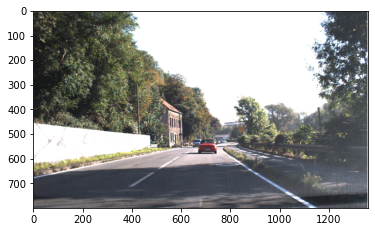

In [11]:
# Teste, ob die Bilder sich anzeigen lassen
# Nutze hier die Listen ppm_filenames, class_ids, die du mit read_txt berechnet hast
img = plt.imread(ppm_file_paths[100])
print("Bildgröße", img.shape)
print("Class ID: ", class_ids[100])
plt.imshow(img)
plt.show()

## Aufgabe 2 – Mapping ClassID – Bezeichnung der Verkehrsschilder
Generiere eine csv-Mapping-Datei aus ReadMe.txt. Nutze dafür alle dir zur Verfügung stehenden Mittel. Python Code ist für diese Aufgabe kein Muss. Die Datei soll das Mapping von Zahl zur Verkehrszeichenbezeichnung enthalten.
Schreibe eine Funktion, die zwei Rückgabewerte zurückgibt:
- pandas-DataFrame aus der generierten csv-Datei und
- eine Dictionary (dict) mit ClassIDs als *keys* und Verkehrsschilderbezeichnungen als *values*.

Nützliche Module / Funktionen:
- pd.read_csv
- os.path
- dict(zip())

In [12]:
###   TO DO   ###
# Generiere eine csv-Mapping-Datei und lege sie in den Datenordner ab
# Definiere die Variable csv_mapping, z.B.: 'tf_signs_mapping.csv' (entspricht dem Namen der generierten Datei)
csv_mapping = 'tf_signs_mapping.csv'

In [13]:
def map_int_to_sign_name(path_to_data_folder, csv_mapping_file):
    """
    Ordnet int-Zahl dem Schildnamen zu
    Argumente: Pfad zum Datenordner, Name der csv-Datei
    Rückgabe:  pandas-DataFrame aus der generierten csv-Datei und 
              eine Dictionary (dict) mit ClassIDs als keys und Traffic Sign Names als values
    """
    
    ###   TO DO   ###
    csv_path = '/Users/yj/Desktop/BGA/UE 1 - Durchführung/FullIJCNN2013/mapping.csv'
    
    assert os.path.exists(csv_path), "Der angegebene Pfad existriert nicht."
    # Lese die csv-Datei als DataFrame ein
    df = pd.read_csv(csv_path)
    
    # dict_mapping-Variable soll eine Dictionary (dict) sein, mit ClassIDs als keys und Traffic Sign Names als values
    dict_mapping = dict(zip(df['ClassID'],df['Traffic Sign Name'] ))
    # oder dict_mapping = df.to_dict()
    
    return dict_mapping, df

In [14]:
dict_mapping, df_map = map_int_to_sign_name(path_to_data, csv_mapping)

In [15]:
# Übersicht der Klassen
df_map.style.hide_index()

ClassID,Traffic Sign Name
0,speed limit 20 (prohibitory)
1,speed limit 30 (prohibitory)
2,speed limit 50 (prohibitory)
3,speed limit 60 (prohibitory)
4,speed limit 70 (prohibitory)
5,speed limit 80 (prohibitory)
6,restriction ends 80 (other)
7,speed limit 100 (prohibitory)
8,speed limit 120 (prohibitory)
9,no overtaking (prohibitory)


## Aufgabe 3 – Visualisierung der Verkehrszeichen
Schreibe eine Funktion, die ein Bild pro Klasse ausgibt. Verwende dafür die Bilder in den Unterordnern, die 
bereits nach **ClassID** genannt sind, um die Klassenzuordnung herzustellen. Für das Mapping verwende Variable **dict_mapping**, die in Aufgabe 2 berechnet wurde.

Nützliche Module / Funktionen:
- interact
- os.path
- list.append

In [16]:
def one_image_per_class(path_to_data_folder):
    """
    Gibt eine Liste mit je einem Bildpfad pro Klasse zurück
    Argumente: Pfad zum Datenordner
    Rückgabe: Liste mit Bildpfaden
    """
    ###   TO DO   ###
    # Definiere eine leere Liste für Bildpfade
    img_paths = []
    
    # Generiere eine Liste mit den Namen der Unterordner. Python os-Modul kann hier nützlich sein
    def f(i):
        return os.path.join(path_to_data_folder,str(i).rjust(2,'0'))
    
    subfolders_paths = list(map(f, dict_mapping.keys()))
    
    # Iteriere über die Unterordner-Pfade und speichere je ein Bildpfad aus den Unterordnern 
    for path in subfolders_paths:
        assert os.path.exists(path), "Der angegebene Pfad existriert nicht."
        # Generiere einen gültigen Bildpfad
        img_path = os.path.join(path, '00000.ppm') # 不确定正误
        assert os.path.exists(img_path), "Der angegebene Pfad existriert nicht."
        
        # Füge jeden Bildpfad der Liste img_paths hinzu
        img_paths.append(img_path)
        
    return img_paths

In [17]:
img_paths_43_classes = one_image_per_class(path_to_data)

In [18]:
def show_img_tr_sign(idx):
    ###   TO DO   ###
    # Definiere eine print()- Funktion deren Ausgabe folgende Form hat:
    # ClassID XY: dazu passende Bezeichnung
    # z.B.: ClassID 25:  construction (danger)
    print('ClassID',list(dict_mapping.keys())[idx],':',list(dict_mapping.values())[idx])
    
    plt.figure(figsize=(6,6))
    img = plt.imread(img_paths_43_classes[idx])
    plt.imshow(img)
    plt.show()

In [19]:
# Nutze interaktive Anzeige, um die Bilder anzusehen
interact(show_img_tr_sign, idx=widgets.IntSlider(min=0,max=len(img_paths_43_classes)-1,step=1, value=0));
# 这里我把 img_paths_43 改成了 img_paths_43_classes，因为 img_paths_43 之前未定义不停的报错
# 下面的 idx 可以移动，从而显示不同的图片

interactive(children=(IntSlider(value=0, description='idx', max=42), Output()), _dom_classes=('widget-interact…

## Aufgabe 4 – Anzeige der ROIs (Regions of Interest)
Schreibe eine Funktion, um innerhalb der angezeigten Bilder die Verkehrsschilder zu markieren. Verwende dafür die Bilder im Hauptordner und die dazugehörige gt.txt. Bedenke, dass jedes Bild nur einmal angezeigt werden soll. 

Nützliche Module / Funktionen:
- dict(zip())
- cv2.rectangle
- cv2.putText

In [69]:
def calc_rois(path_to_data_folder, csv_mapping_file, gt_txt_file):
    """
    Zeichnet ROIs und deren Bezeichnungen in die Bilder ein
    Argumente: Pfad zum heruntergeladenen Datenordner, Dateinamen
    Rückgabe:  Liste mit Bildern 
    """
    # Die Funktionen map_int_to_sign_name und read_txt sollten bereits implementiert sein  
    map_tr_sing_int, df_map = map_int_to_sign_name(path_to_data_folder, csv_mapping_file)
    ppm_filenames, class_ids, rois = read_txt(path_to_data_folder, gt_txt_file) 
    
    ###   TO DO   ###
    # Definiere eine leere Liste für die Speicherung von Bildern
    data = []
    # Definiere ein leeres Dictionary
    data_dict = {}
    
    curr_path = ""
    img = None
    counter_identical_path = 0
    # Bevor du weitermachst, versuche zu verstehen, was in if- und else-Blöcken der Schleife passiert
    for idx, file_path in enumerate(ppm_filenames):
        if curr_path != file_path: 
            curr_path = file_path
            # Lese ein Bild ein
            img = plt.imread(file_path)
            counter_identical_path = 1
            # Definiere Koordinaten für die Positionierung des Textfeldes mit Beschreibung des Verkehrszeichens
            initial_x_coordinate = 100 
            initial_y_coordinate = 50
            # Bei dieser Variable handelt es sich um org-Parameter der cv2.putText
            org_id_meaning = (initial_x_coordinate, initial_y_coordinate)
        else:
            counter_identical_path += 1
            # Passe die x-Koordinate für jedes weitere Verkehrszeichen an
            # Folgende Zeilen sind eventuell optional 
            # Es hängt davon ab, wo du die Bezeichnung positionierst 
            initial_y_coordinate += 50
            org_id_meaning = (initial_x_coordinate, initial_y_coordinate)
        
        # Berechne Koordinaten des Rechtecks, benutze dafür die Variable rois
        point1 = (rois[idx][0],rois[idx][1]) 
        point2 = (rois[idx][2],rois[idx][3])
        
        # Zeichne das Rechteck mit Hilfe der berechneten Koordinaten in das Bild (cv2.rectangle) ein
        img = cv2.rectangle(img, point1, point2, (0,0,255),5)
        
        # Ermittle Koordinaten für das Textfeld
        org = (rois[idx][2] + 10, rois[idx][1] + 20)
        # Speichere Verkehrszeichen-ID als string
        text = str(class_ids[idx])
        # Nutze cv2.putText um die Verkehrszeichen-ID neben dem entsprechenden Verkehrszeichen zu positionieren
        img = cv2.putText(img, text, org, cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0),5)
        
        # Speichere Verkehrszeichen-ID mit der dazugehörigen Bezeichnung als string
        text_id_meaning = ':'.join(map(str,list(map_tr_sing_int.items())[class_ids[idx]]))
        # text_id_meaning = str(list(map_tr_sing_int.items())[class_ids[idx]])
        # text_id_meaning = str(list(map_tr_sing_int.keys())[class_ids[idx]]) + str(list(map_tr_sing_int.values())[class_ids[idx]])
        # Nutze cv2.putText um text_id_meaning im Bild zu positionieren
        img = cv2.putText(img, text_id_meaning, org_id_meaning, cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0),5)
        
        # Füge jedes Bild der data-Liste hinzu
        data.append(img)
        
    # Benutze die Verkettung dict(zip()). Die Dictionary soll Pfadnamen als keys und Bilder als Dictionaries enthalten 
    data_dict = dict(zip(ppm_filenames, data))
    # Schpeichere die Bilder aus data_dict in die Liste
    data_list = list(data_dict.values())
    
    return data_list

In [70]:
data = calc_rois(path_to_data, csv_mapping, gt_txt)                                     

741


In [67]:
def show_img(idx):
    '''
    Helper-Funktion, die als erstes Parameter bei interact eingesetzt wird
    '''
    plt.figure(figsize=(16,8))
    plt.imshow(data[idx])
    plt.show()

In [68]:
interact(show_img, idx=widgets.IntSlider(min=0,max=len(data),step=1, value=0));

interactive(children=(IntSlider(value=0, description='idx', max=741), Output()), _dom_classes=('widget-interac…

<Figure size 1152x576 with 0 Axes>

## GESCHAFFT !!!